In [1]:

import pandas as pd

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

from sklearn.feature_extraction.text import TfidfVectorizer
import spacy

# TruncatedSVD from sklearn
from sklearn.decomposition import TruncatedSVD

from sklearn.cluster import DBSCAN

# EDA

Let's open the dataset and see what it looks like and if there are missing data

In [2]:
dataset = pd.read_csv("sample-data.csv")
dataset.head()

,id,description
0,1,Active classic boxers - There's a reason why o...
1,2,Active sport boxer briefs - Skinning up Glory ...
2,3,Active sport briefs - These superbreathable no...
3,4,"Alpine guide pants - Skin in, climb ice, switc..."
4,5,"Alpine wind jkt - On high ridges, steep ice an..."


In [3]:
dataset.isna().sum()
#no missing data

id             0
description    0
dtype: int64

In [4]:
dataset.shape


(500, 2)

In [5]:
#Let's have a look at one description
dataset.loc[0,"description"]

'Active classic boxers - There\'s a reason why our boxers are a cult favorite - they keep their cool, especially in sticky situations. The quick-drying, lightweight underwear takes up minimal space in a travel pack. An exposed, brushed waistband offers next-to-skin softness, five-panel construction with a traditional boxer back for a classic fit, and a functional fly. Made of 3.7-oz 100% recycled polyester with moisture-wicking performance. Inseam (size M) is 4 1/2". Recyclable through the Common Threads Recycling Program.<br><br><b>Details:</b><ul> <li>"Silky Capilene 1 fabric is ultralight, breathable and quick-to-dry"</li> <li>"Exposed, brushed elastic waistband for comfort"</li> <li>5-panel construction with traditional boxer back</li> <li>"Inseam (size M) is 4 1/2"""</li></ul><br><br><b>Fabric: </b>3.7-oz 100% all-recycled polyester with Gladiodor natural odor control for the garment. Recyclable through the Common Threads Recycling Program<br><br><b>Weight: </b>99 g (3.5 oz)<br><b

Overall, the dataset is pretty straigh forward
- 500 lines
- No missing data
- 2 columns : id and description

Let's start the text preprocessing to be able to cluster the item together

# Preprocessing

For the preprocessing, we will use the standard setup
- clean the text by removing punctuation and lowering the case
- text tokenization
- removal of stop words

In [3]:
# Importing english
import en_core_web_sm
nlp = en_core_web_sm.load()

In [4]:
#Let's clean the text by removing punctuation and lowering the case
dataset['clean_description'] = dataset['description'].str.replace(r"[^A-Za-z0-9 ]+", " ", regex = True)
dataset['clean_description']  = dataset['clean_description'].apply(lambda x: x.lower())
dataset.head()

,id,description,clean_description
0,1,Active classic boxers - There's a reason why o...,active classic boxers there s a reason why o...
1,2,Active sport boxer briefs - Skinning up Glory ...,active sport boxer briefs skinning up glory ...
2,3,Active sport briefs - These superbreathable no...,active sport briefs these superbreathable no...
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...


In [5]:
from spacy.lang.en.stop_words import STOP_WORDS

#tokenization
tokenized_doc = dataset['clean_description'].fillna(' ').apply(lambda x: nlp(x))
tokenized_doc

0      (active, classic, boxers,   , there, s, a, rea...
1      (active, sport, boxer, briefs,   , skinning, u...
2      (active, sport, briefs,   , these, superbreath...
3      (alpine, guide, pants,   , skin, in,  , climb,...
4      (alpine, wind, jkt,   , on, high, ridges,  , s...
                             ...                        
495    (cap, 2, bottoms,   , cut, loose, from, the, m...
496    (cap, 2, crew,   , this, crew, takes, the, edg...
497    (all, time, shell,   , no, need, to, use, that...
498    (all, wear, cargo, shorts,   , all, wear, carg...
499    (all, wear, shorts,   , time, to, simplify,  ,...
Name: clean_description, Length: 500, dtype: object

In [6]:
#remove stop words
tokenized_doc = tokenized_doc.apply(lambda doc: [token.lemma_ for token in doc if token.text not in STOP_WORDS])
tokenized_doc

0      [active, classic, boxer,   , s, reason, boxer,...
1      [active, sport, boxer, brief,   , skin, glory,...
2      [active, sport, brief,   , superbreathable, fl...
3      [alpine, guide, pant,   , skin,  , climb, ice,...
4      [alpine, wind, jkt,   , high, ridge,  , steep,...
                             ...                        
495    [cap, 2, bottom,   , cut, loose, madden, crowd...
496    [cap, 2, crew,   , crew, take, edge, fickle, w...
497    [time, shell,   , need, use, morning, time, um...
498    [wear, cargo, short,   , wear, cargo, short, b...
499    [wear, short,   , time, simplify,  , wear, sho...
Name: clean_description, Length: 500, dtype: object

In [7]:
# add a clean token column 
dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]
dataset.head()

,id,description,clean_description,clean_token
0,1,Active classic boxers - There's a reason why o...,active classic boxers there s a reason why o...,active classic boxer s reason boxer cult fa...
1,2,Active sport boxer briefs - Skinning up Glory ...,active sport boxer briefs skinning up glory ...,active sport boxer brief skin glory require...
2,3,Active sport briefs - These superbreathable no...,active sport briefs these superbreathable no...,active sport brief superbreathable fly brie...
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch...
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpi...


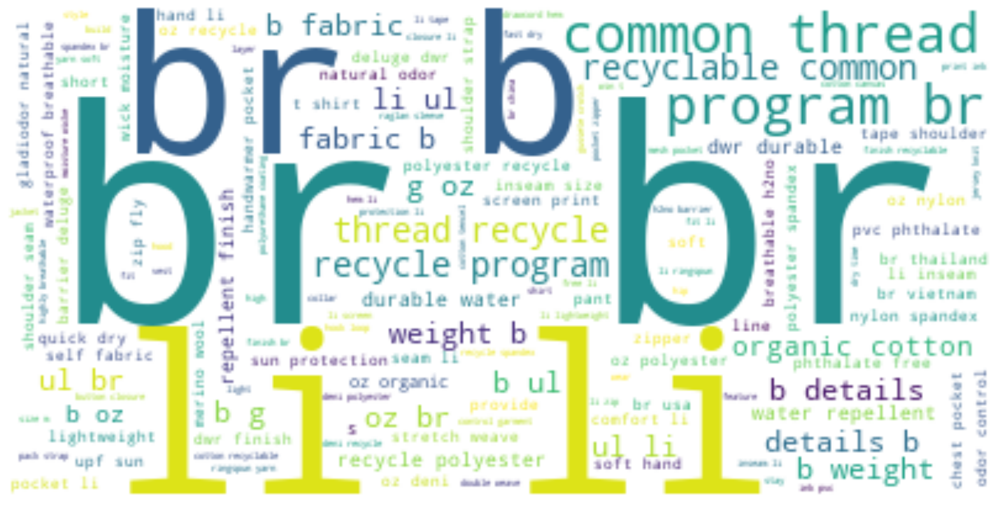

In [8]:
# Import necessary libraries
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import wordcloud
import pandas as pd

# Sample dataset for demonstration (remove this line if you already have a dataset)
# dataset = pd.DataFrame({"clean_token": ["example text here"]})

# Instantiate WordCloud
wd = wordcloud.WordCloud(background_color="white", contour_width=1, contour_color='steelblue')

# Join all text data into one string
all_text = " ".join(dataset["clean_token"])

# Generate the word cloud
cloud = wd.generate(all_text)

# Show plot
plt.figure(figsize=(20, 20))
plt.imshow(cloud, interpolation='bilinear')
plt.axis("off")
plt.show()


It seems we need to add some words to the spotwords list to remove the common word 

To remove the most common we will
- create a corpus with all the works of the clean text
- check the output format
- Use a NLP model on the corpus
- create a list of lemmatied tokens 
- check the text that are appearing more than 200 times and add them as stop words

In [9]:
# Join all words to create a corpus
corpus = ' '.join(dataset['clean_token'].astype(str))
type(corpus)



str

In [10]:
doc = nlp(corpus)


In [11]:
# Create lemmatization 
lemma = [token.lemma_ for token in doc if token.lemma_ not in STOP_WORDS]

# Create a DataFrame of lemmatized token
lemmadf = pd.Series(lemma)

# Create a mask of all counted values greater than 1000
common = lemmadf.value_counts()>800

# Apply mask
common = common[common]

common.shape

(10,)

In [12]:
#Here is an overview of the most comming text
common

           True
li         True
           True
br         True
b          True
oz         True
recycle    True
ul         True
fabric     True
pocket     True
Name: count, dtype: bool

In [13]:
# Update stop words 
new_stop_words = common.index

# Create a union of sets 
STOP_WORDS_updated = STOP_WORDS.union(new_stop_words)

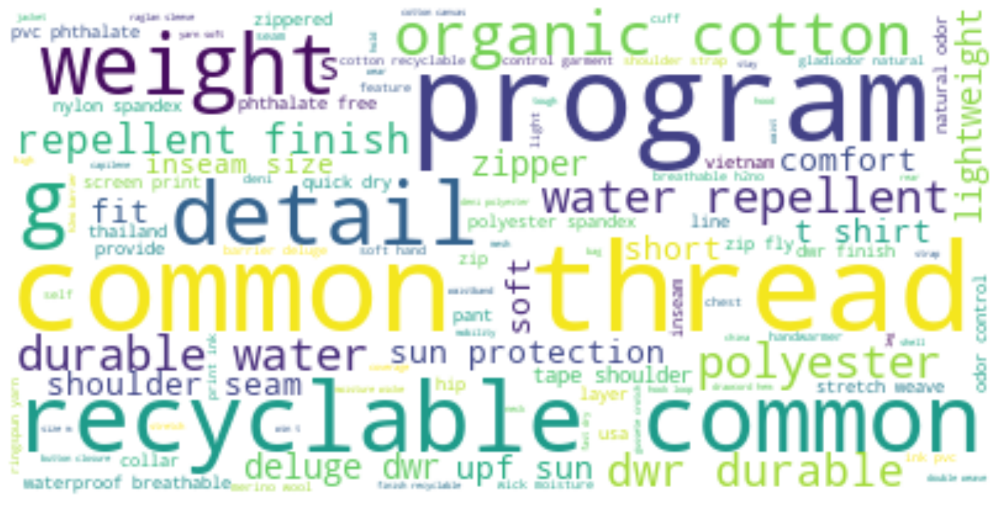

In [14]:
# Import necessary libraries
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import wordcloud
import pandas as pd


# Instantiate WordCloud
wd = wordcloud.WordCloud(background_color="white", contour_width=1, contour_color='steelblue', stopwords=STOP_WORDS_updated)

# Join all text data into one string
all_text = " ".join(dataset["clean_token"])

# Generate the word cloud
cloud = wd.generate(all_text)

# Show plot
plt.figure(figsize=(20, 20))
plt.imshow(cloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# Clustering

Now that we remove the useless words, let's try to clusterize the dataset

For this we will
- create the TF_IDF vector to get the most important words per description
- Used DBScan to create cluster based on the TF_IDF columns
- Loop on epsilon on min samples to get the best parameters
- The optimal parameters is manually selected to get the minimimum number of cluster without have too many outliers

In [15]:
from sklearn.feature_extraction import text 

#Customer creation of stop words including the most common words of the dataset
stop_words = text.ENGLISH_STOP_WORDS.union(common.index)

#Update of the clean token column to remove the additional spot words
tokenized_doc = dataset['clean_description'].fillna(' ').apply(lambda x: nlp(x))
tokenized_doc = tokenized_doc.apply(lambda doc: [token.lemma_ for token in doc if token.text not in stop_words])
dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]


In [16]:
# Tfidf transformer 
from sklearn.feature_extraction.text import TfidfVectorizer

# TF-IDF vector
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(dataset['clean_token'])

# X is a generator. We can transform that as an array
dense = X.toarray()
dense

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [179]:
eps = [0.57, 0.6, 0.62 ,0.63, 0.64, 0.65,0.68,0.69,0.70,0.72]
min_sample = [2,3,4]

for e in eps:
    for m in min_sample:
        print("---------------")
        print('epsilon : {} - min sample - {}'.format(e,m))
        dbscan = DBSCAN(eps=e, min_samples=m,metric='cosine')
        dbscan.fit(X)
        print("Number of clusters")
        print(np.unique(dbscan.labels_))

        dataset["Cluster_DBScan"] = dbscan.labels_
        dataset[dataset["Cluster_DBScan"]!=-1].head()
        print("Number of outliers")
        print(dataset[dataset['Cluster_DBScan']==-1].shape[0])
        print("---------------")

---------------
epsilon : 0.57 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46
 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70
 71 72 73 74 75 76 77 78 79 80 81 82]
Number of outliers
99
---------------
---------------
epsilon : 0.57 - min sample - 3
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37]
Number of outliers
189
---------------
---------------
epsilon : 0.57 - min sample - 4
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31]
Number of outliers
210
---------------
---------------
epsilon : 0.6 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 4

With epsilon equal to  0.7 and min sample to 3, we ends up with a good compromise with 16  clusters and 32 outliers

Now : 
- let's calculate the cluster based on the optimal parameters
- bring the clusters back in the dataset
- Loop on each clusters to get create the world cloud for all of them

In [17]:
dbscan = DBSCAN(eps=0.7, min_samples=3,metric='cosine')
dbscan.fit(X)

DBSCAN(eps=0.7, metric='cosine', min_samples=3)

In [18]:
dataset["Cluster_DBScan"] = dbscan.labels_
dataset.head()

,id,description,clean_description,clean_token,Cluster_DBScan
0,1,Active classic boxers - There's a reason why o...,active classic boxers there s a reason why o...,active classic boxer s reason boxer cult favor...,0
1,2,Active sport boxer briefs - Skinning up Glory ...,active sport boxer briefs skinning up glory ...,active sport boxer brief skin glory require mo...,0
2,3,Active sport briefs - These superbreathable no...,active sport briefs these superbreathable no...,active sport brief superbreathable fly brief m...,0
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch ro...,1
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpine ...,1


----------------
Cluster #0


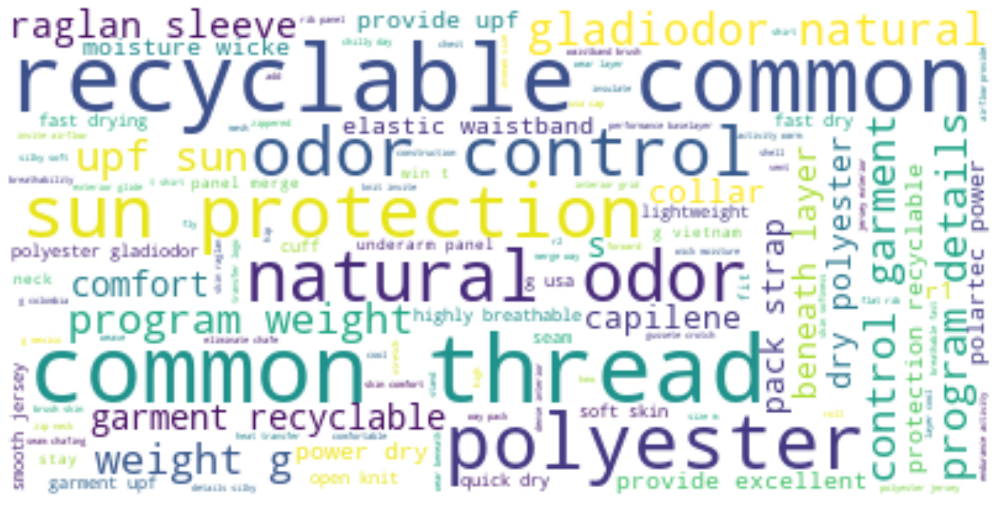

----------------
Cluster #1


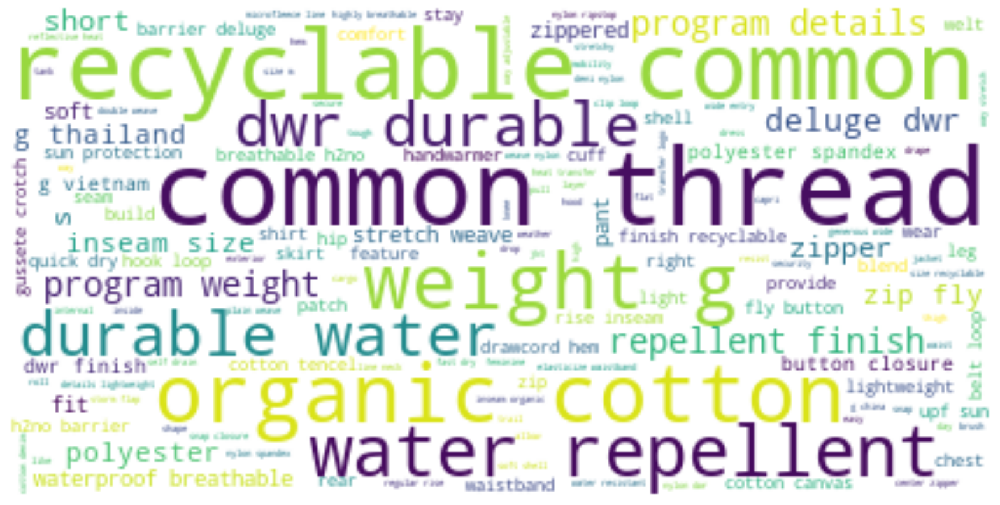

----------------
Cluster #2


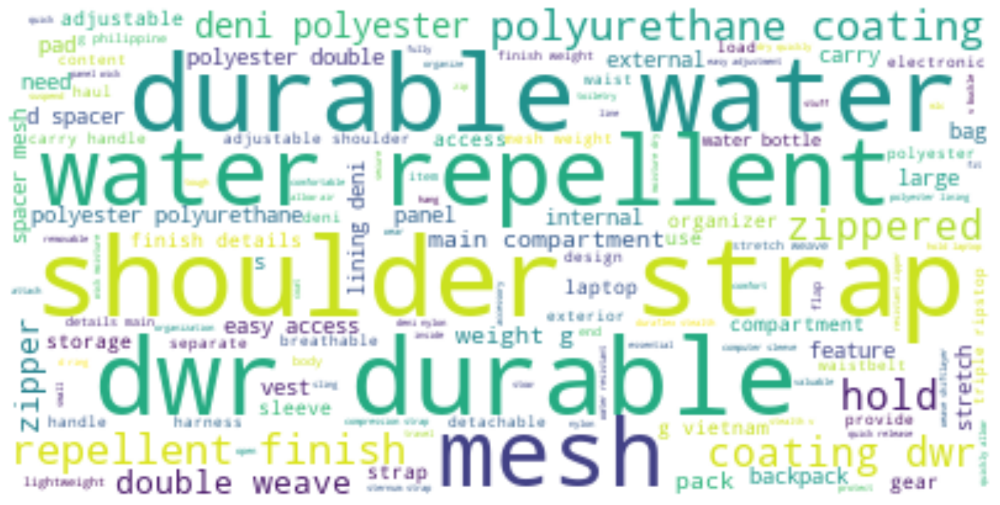

In [19]:
dataset_wo_cluster = dataset[dataset['Cluster_DBScan']!=-1]

# Instantiate WordCloud
wd = wordcloud.WordCloud(background_color="white", contour_width=1, contour_color='steelblue', stopwords=STOP_WORDS_updated)

list_cluster = dataset_wo_cluster["Cluster_DBScan"].unique()

for i in list_cluster[0:3] :
    # Join all text data into one string
    all_text = " ".join(dataset_wo_cluster[dataset_wo_cluster["Cluster_DBScan"]==i]["clean_token"])

    # Generate the word cloud
    cloud = wd.generate(all_text)

    print("----------------")
    print('Cluster #{}'.format(list_cluster [i]))

    # Show plot
    plt.figure(figsize=(20, 20))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [20]:
#Here is an onverview of the number of item per clusters. High number ends up in the cluster 1
dataset['Cluster_DBScan'].value_counts()

Cluster_DBScan
 1     193
 0      65
 6      58
-1      32
 2      29
 9      24
 3      22
 5      22
 4      10
 7       8
 12      7
 8       7
 11      5
 10      4
 14      4
 15      4
 13      3
 16      3
Name: count, dtype: int64

In [189]:
#The dataset 0 is relatively generic as it includes lots of different type of clothes. Let's see if we can create sub-cluster inside it
dataset[dataset['Cluster_DBScan']==1]

,id,description,clean_description,clean_token,Cluster_DBScan
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch ro...,1
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpine ...,1
5,6,Ascensionist jkt - Our most technical soft she...,ascensionist jkt our most technical soft she...,ascensionist jkt technical soft shell mountain...,1
8,9,Baby micro d-luxe cardigan - Micro D-Luxe is a...,baby micro d luxe cardigan micro d luxe is a...,baby micro d luxe cardigan micro d luxe heaven...,1
11,12,"Baggies shorts - Even Baggies, our most popula...",baggies shorts even baggies our most popula...,baggies short baggie popular short occas...,1
...,...,...,...,...,...
483,484,Borderless trek pants - The Ruby Crest trail r...,borderless trek pants the ruby crest trail r...,borderless trek pant ruby crest trail run dire...,1
484,485,Borderless trek zip-off pants - Made for techn...,borderless trek zip off pants made for techn...,borderless trek zip pant technical performance...,1
497,498,All-time shell - No need to use that morning T...,all time shell no need to use that morning t...,time shell need use morning time umbrella ti...,1
498,499,All-wear cargo shorts - All-Wear Cargo Shorts ...,all wear cargo shorts all wear cargo shorts ...,wear cargo short wear cargo short bask glory s...,1


In [190]:
#Let's see if we can take the cluster 0 and remove stop words to be able to create cluster inside this cluster
sub_dataset = dataset[dataset['Cluster_DBScan']==1]


In [193]:
# Join all words to create a corpus
corpus = ' '.join(sub_dataset['clean_token'].astype(str))
type(corpus)

doc = nlp(corpus)


# Create lemmatization 
lemma = [token.lemma_ for token in doc if token.lemma_ not in stop_words]

# Create a DataFrame of lemmatized token
lemmadf = pd.Series(lemma)

# Create a mask of all counted values greater than 200 
sub_common = lemmadf.value_counts()>200

# Apply mask
sub_common = sub_common[sub_common]

sub_common.shape

(15,)

In [194]:
sub_common

recyclable    True
thread        True
common        True
program       True
zipper        True
durable       True
dwr           True
polyester     True
water         True
finish        True
organic       True
cotton        True
weight        True
5             True
2             True
Name: count, dtype: bool

In [195]:

from sklearn.feature_extraction import text 

#Customer creation of stop words including the most common words of the dataset
sub_stop_words = text.ENGLISH_STOP_WORDS.union(sub_common.index)

#Update of the clean token column to remove the additional spot words
tokenized_doc = sub_dataset['clean_description'].fillna(' ').apply(lambda x: nlp(x))
tokenized_doc = tokenized_doc.apply(lambda doc: [token.lemma_ for token in doc if token.text not in sub_stop_words])
sub_dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]

# Tfidf transformer 
from sklearn.feature_extraction.text import TfidfVectorizer

# TF-IDF vector
vectorizer = TfidfVectorizer(stop_words='english')
X = vectorizer.fit_transform(sub_dataset['clean_token'])

# X is a generator. We can transform that as an array
dense = X.toarray()
dense



C:\Users\Utilisateur\AppData\Local\Temp\ipykernel_12568\1733890262.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_dataset['clean_token'] = [" ".join(x) for x in tokenized_doc]


array([[0.        , 0.        , 0.        , ..., 0.10395649, 0.10016341,
        0.        ],
       [0.        , 0.        , 0.04381661, ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.08337648,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [196]:
eps = [0.4, 0.41, 0.45, 0.5,0.55, 0.57, 0.6, 0.62, 0.65]
min_sample = [2,3,4,5,6,7]

for e in eps:
    for m in min_sample:
        print("---------------")
        print('epsilon : {} - min sample - {}'.format(e,m))
        dbscan = DBSCAN(eps=e, min_samples=m,metric='cosine')
        dbscan.fit(X)
        print("Number of clusters")
        print(np.unique(dbscan.labels_))

        sub_dataset["Cluster_DBScan"] = dbscan.labels_
        sub_dataset[sub_dataset["Cluster_DBScan"]!=-1].head()
        print("Number of outliers")
        print(sub_dataset[sub_dataset['Cluster_DBScan']==-1].shape[0])
        print("---------------")

---------------
epsilon : 0.4 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45]
Number of outliers
77
---------------
---------------
epsilon : 0.4 - min sample - 3
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12]
Number of outliers
143
---------------
---------------
epsilon : 0.4 - min sample - 4
Number of clusters
[-1  0  1  2  3  4  5]
Number of outliers
164
---------------
---------------
epsilon : 0.4 - min sample - 5
Number of clusters
[-1  0  1  2]
Number of outliers
176
---------------
---------------
epsilon : 0.4 - min sample - 6
Number of clusters
[-1  0  1]
Number of outliers
181
---------------
---------------
epsilon : 0.4 - min sample - 7
Number of clusters
[-1]
Number of outliers
193
---------------
---------------
epsilon : 0.41 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

C:\Users\Utilisateur\AppData\Local\Temp\ipykernel_12568\2091626491.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_dataset["Cluster_DBScan"] = dbscan.labels_


Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45]
Number of outliers
68
---------------
---------------
epsilon : 0.45 - min sample - 3
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
Number of outliers
130
---------------
---------------
epsilon : 0.45 - min sample - 4
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9]
Number of outliers
146
---------------
---------------
epsilon : 0.45 - min sample - 5
Number of clusters
[-1  0  1  2]
Number of outliers
174
---------------
---------------
epsilon : 0.45 - min sample - 6
Number of clusters
[-1  0  1]
Number of outliers
179
---------------
---------------
epsilon : 0.45 - min sample - 7
Number of clusters
[-1]
Number of outliers
193
---------------
---------------
epsilon : 0.5 - min sample - 2
Number of clusters
[-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23 24 25 26 27

In [197]:
dbscan = DBSCAN(eps=0.65, min_samples=3,metric='cosine')
dbscan.fit(X)

sub_dataset["Cluster_DBScan"] = dbscan.labels_
sub_dataset.head()

C:\Users\Utilisateur\AppData\Local\Temp\ipykernel_12568\3802748635.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_dataset["Cluster_DBScan"] = dbscan.labels_


,id,description,clean_description,clean_token,Cluster_DBScan
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch...,0
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpi...,0
5,6,Ascensionist jkt - Our most technical soft she...,ascensionist jkt our most technical soft she...,ascensionist jkt technical soft shell mount...,0
8,9,Baby micro d-luxe cardigan - Micro D-Luxe is a...,baby micro d luxe cardigan micro d luxe is a...,baby micro d luxe cardigan micro d luxe hea...,1
11,12,"Baggies shorts - Even Baggies, our most popula...",baggies shorts even baggies our most popula...,baggies short baggie popular short oc...,0


In [198]:
sub_dataset["Cluster_DBScan"].value_counts()

Cluster_DBScan
 0    151
 4     13
 2      8
-1      8
 3      5
 1      4
 5      4
Name: count, dtype: int64

In [205]:
sub_dataset[sub_dataset['Cluster_DBScan']==-0]

,id,description,clean_description,clean_token,Cluster_DBScan
3,4,"Alpine guide pants - Skin in, climb ice, switc...",alpine guide pants skin in climb ice switc...,alpine guide pant skin climb ice switch...,0
4,5,"Alpine wind jkt - On high ridges, steep ice an...",alpine wind jkt on high ridges steep ice an...,alpine wind jkt high ridge steep ice alpi...,0
5,6,Ascensionist jkt - Our most technical soft she...,ascensionist jkt our most technical soft she...,ascensionist jkt technical soft shell mount...,0
11,12,"Baggies shorts - Even Baggies, our most popula...",baggies shorts even baggies our most popula...,baggies short baggie popular short oc...,0
14,15,Borderless shorts-11 in. - Go forward where ot...,borderless shorts 11 in go forward where ot...,borderless short 11 forward cringe borde...,0
...,...,...,...,...,...
483,484,Borderless trek pants - The Ruby Crest trail r...,borderless trek pants the ruby crest trail r...,borderless trek pant ruby crest trail run d...,0
484,485,Borderless trek zip-off pants - Made for techn...,borderless trek zip off pants made for techn...,borderless trek zip pant technical performa...,0
497,498,All-time shell - No need to use that morning T...,all time shell no need to use that morning t...,time shell need use morning time umbrella ...,0
498,499,All-wear cargo shorts - All-Wear Cargo Shorts ...,all wear cargo shorts all wear cargo shorts ...,wear cargo short wear cargo short bask glor...,0


In [214]:
#let's merge the dataset, merge the clustering and save it to use it later on
merged_dataset = pd.merge(
    dataset,
    sub_dataset[['id', 'Cluster_DBScan']],  # Select only needed columns from sub_dataset
    on='id',
    how='left'  # Use left join to keep all records from dataset
)

merged_dataset['Cluster_DBScan_y'] = merged_dataset['Cluster_DBScan_y'].fillna('None')

merged_dataset["Final_Cluster"] = merged_dataset["Cluster_DBScan_x"].astype(str)+ "_" + merged_dataset["Cluster_DBScan_y"].astype(str)

dataset_to_save = merged_dataset[["id","description","Final_Cluster"]]
dataset_to_save.to_csv("final_clustering.csv")

# Recommender System

Based on the clustering
- Load the final clustering saved as csv
- Extract the list of items with the same cluster
- Show 5 of the items in the same cluster

In [21]:
def find_similar_item():
    #Load dataset
    dataset = pd.read_csv("final_clustering.csv")
    
    # Convert input to integer and handle ValueError
    try: 
        id = int(input('Please provide the item id: '))
    except ValueError:
        print("The input does not contain a valid integer.")
        return

    # Check if the id exists in the dataset
    if id not in dataset['id'].values:
        print('The id is not in the catalogue')
        return

    #Showing the selected item
    print("Here is the item you selected")
    print(dataset.loc[dataset['id']==id,"description"].values[0])


    # Retrieve the cluster for the given id and find similar items
    cluster = dataset.loc[dataset['id'] == id, "Final_Cluster"].values[0]
    df_cluster = dataset[dataset['Final_Cluster'] == cluster]

    # Exclude the original item
    df_cluster = df_cluster[df_cluster['id'] != id]

    # Display similar items, limit to 5 descriptions
    print('Here is a selection of similar items:')
    for i, description in enumerate(df_cluster['description'].head(5), start=1):
        print(f"{i}: {description}")


Let's see how we can use this recommender

In [22]:
find_similar_item()

Here is the item you selected
Merino 2 polo - The feel is bohemian, the look should at least get your foot in the door. Designed for an active lifestyle in warm to cool weather, Merino 2 is made from 73% merino wool wrapped around an all-recycled polyester (27%) core for a luxurious hand, an improved dry time and enduring strength. Inherently soft and comfortable, merino naturally resists odor, moves moisture away from the skin, regulates body temperature, and stretches. Features include set-in sleeves and offset shoulder seams that won't chafe beneath pack straps, a soft double-layered collar for comfort and a fully covered zip-neck that feels smooth against the skin. We slow-wash our merino for next-to-skin softness. Machine-wash cold; lay flat to dry. Recyclable through the Common Threads Recycling Program.<br><br><b>Details:</b><ul> <li>"Slow-washed merino wool resists odor naturally, insulates even when wet, is durable and stretches, provides superior performance and softness dry"

# Topic Modeling

Now that the recommender system is available, let's use topic modeling algorithm to assess the latent topics in description

- Topic Extraction: Using TruncatedSVD to extract 20 latent topics from the document-term matrix
- Document-Topic Assignment: Creating a dataframe that shows the relationship between documents and topics
- Topic Visualization: Generating word clouds for each topic to visualize the most important words


In [24]:
svd_model = TruncatedSVD(n_components=20, algorithm='randomized', n_iter=100)
lsa = svd_model.fit_transform(X)

topic_encoded_df = pd.DataFrame(lsa, columns = ["topic_{}".format(i+1) for i in range(20)], index = dataset.index)
topic_encoded_df["text"] = dataset['clean_token'].values
topic_encoded_df

,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,...,topic_12,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20,text
0,0.268745,-0.058918,0.178303,0.081509,-0.118084,-0.012315,-0.058128,-0.000995,-0.133540,-0.060146,...,-0.062565,-0.035640,0.022659,0.037267,0.035907,-0.020967,-0.034770,0.036788,-0.025041,active classic boxer s reason boxer cult favor...
1,0.281322,-0.075080,0.093548,0.099024,-0.014862,0.110511,-0.065556,-0.016273,-0.125965,0.022971,...,-0.174063,0.008904,0.054605,-0.065284,0.024031,0.079842,0.081437,-0.016555,-0.017974,active sport boxer brief skin glory require mo...
2,0.267322,-0.094437,0.101829,0.026202,-0.013978,0.122243,0.018503,0.058463,-0.049523,0.009008,...,-0.186950,0.070830,0.063204,-0.070278,-0.012497,0.058011,0.076089,0.028638,0.006955,active sport brief superbreathable fly brief m...
3,0.386113,-0.263062,-0.131256,-0.129194,0.029801,-0.040886,-0.026841,-0.057353,-0.113501,0.112587,...,-0.085700,-0.177606,-0.059748,0.026398,-0.016839,0.015724,0.219635,0.106215,0.003140,alpine guide pant skin climb ice switch ro...
4,0.389911,-0.279719,-0.046275,-0.219591,-0.042162,-0.033622,0.028489,0.049339,-0.038881,0.190682,...,0.002256,-0.212233,0.283520,0.068430,-0.043446,-0.069422,-0.024088,-0.001939,-0.012308,alpine wind jkt high ridge steep ice alpine ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,0.320870,-0.092545,0.383835,0.065612,-0.265615,-0.043755,-0.038028,-0.073290,-0.309222,-0.186613,...,-0.040661,-0.082593,0.007238,-0.015797,0.026988,-0.073256,0.044531,0.052687,-0.064571,cap 2 bottom cut loose madden crowd search und...
496,0.347156,-0.087237,0.478301,-0.019352,-0.317430,-0.051512,0.015874,0.017193,-0.201400,-0.214757,...,0.087526,-0.102274,0.099338,-0.080241,0.074123,-0.051609,0.100399,-0.059143,-0.085097,cap 2 crew crew take edge fickle weather cle...
497,0.346364,-0.235635,-0.094320,-0.241964,-0.013410,-0.173080,0.103447,-0.154704,0.064569,-0.031896,...,0.099951,0.087871,-0.038643,0.008501,0.029593,-0.004793,-0.040246,0.017683,-0.020134,time shell need use morning time umbrella ti...
498,0.319808,0.052481,-0.131452,0.338436,0.025036,-0.146944,-0.132701,0.009307,-0.085195,-0.044889,...,0.145443,0.118527,0.091300,-0.083475,-0.161986,-0.097700,0.000698,-0.225792,-0.066867,wear cargo short wear cargo short bask glory s...


In [25]:
columns = ["topic_{}".format(i+1) for i in range(20)]
topic_encoded_df['max_column'] = topic_encoded_df[columns].abs().idxmax(axis=1)
topic_encoded_df.head()

,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,...,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20,text,max_column
0,0.268745,-0.058918,0.178303,0.081509,-0.118084,-0.012315,-0.058128,-0.000995,-0.133540,-0.060146,...,-0.035640,0.022659,0.037267,0.035907,-0.020967,-0.034770,0.036788,-0.025041,active classic boxer s reason boxer cult favor...,topic_1
1,0.281322,-0.075080,0.093548,0.099024,-0.014862,0.110511,-0.065556,-0.016273,-0.125965,0.022971,...,0.008904,0.054605,-0.065284,0.024031,0.079842,0.081437,-0.016555,-0.017974,active sport boxer brief skin glory require mo...,topic_1
2,0.267322,-0.094437,0.101829,0.026202,-0.013978,0.122243,0.018503,0.058463,-0.049523,0.009008,...,0.070830,0.063204,-0.070278,-0.012497,0.058011,0.076089,0.028638,0.006955,active sport brief superbreathable fly brief m...,topic_1
3,0.386113,-0.263062,-0.131256,-0.129194,0.029801,-0.040886,-0.026841,-0.057353,-0.113501,0.112587,...,-0.177606,-0.059748,0.026398,-0.016839,0.015724,0.219635,0.106215,0.003140,alpine guide pant skin climb ice switch ro...,topic_1
4,0.389911,-0.279719,-0.046275,-0.219591,-0.042162,-0.033622,0.028489,0.049339,-0.038881,0.190682,...,-0.212233,0.283520,0.068430,-0.043446,-0.069422,-0.024088,-0.001939,-0.012308,alpine wind jkt high ridge steep ice alpine ...,topic_1


In [26]:
topic = pd.DataFrame(svd_model.components_, index = columns)
topic.columns= vectorizer.get_feature_names_out()
topic_t = topic.transpose()
topic_t

,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14,topic_15,topic_16,topic_17,topic_18,topic_19,topic_20
000,0.002653,0.000121,-0.001403,-0.003940,0.002216,0.002345,0.002744,0.001825,-0.003709,0.004746,0.000648,-0.000049,0.001063,0.009108,-0.005724,-0.004171,0.000970,0.004825,0.012424,-0.003205
03,0.000542,-0.000729,-0.000747,-0.001351,0.000346,-0.001123,0.000665,-0.001813,0.001027,-0.001893,-0.000045,0.001565,0.000989,-0.001094,-0.000671,-0.000313,-0.000282,-0.000138,-0.000210,-0.000600
10,0.049771,-0.009271,-0.045209,0.085681,0.012105,-0.042948,0.019180,0.020615,0.008076,-0.026930,0.011643,-0.005256,0.001437,0.031627,0.029072,0.079716,0.033518,0.020474,0.075261,0.035788
100,0.136170,0.051339,-0.016032,-0.056515,-0.065844,-0.034410,-0.042692,0.063483,-0.001389,-0.034906,0.018267,0.082251,0.027731,0.030877,0.024231,0.071954,-0.042728,-0.051349,0.031584,0.041536
1000,0.000403,-0.000448,-0.000348,-0.001257,0.000383,0.000184,-0.000434,0.003258,0.000117,-0.002797,0.000407,0.001055,0.001859,-0.001025,-0.001470,0.001024,0.002061,-0.000069,-0.000426,-0.000582
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
zipper,0.096167,-0.113896,-0.063502,-0.117646,-0.014220,-0.071055,0.018775,0.005280,-0.033239,0.058318,0.032858,0.078856,0.044049,-0.047611,-0.086662,0.000383,0.062467,0.057831,0.024436,0.015109
zippered,0.056129,-0.064194,-0.051634,-0.051572,0.004932,-0.002450,-0.034657,0.043211,-0.015671,0.030130,-0.005419,-0.007694,-0.015817,-0.044264,0.007448,0.016037,0.009109,0.033903,-0.009816,-0.025151
zippers,0.005950,-0.008017,-0.007312,-0.007886,0.003432,-0.002748,-0.002719,-0.003775,-0.007181,0.004696,-0.001361,-0.002727,-0.016480,-0.008200,-0.002915,-0.000961,0.003504,0.014624,0.008991,-0.000318
zips,0.014032,-0.020627,-0.017524,-0.027905,0.004798,-0.017526,0.011068,-0.047766,0.020049,-0.029294,0.001490,0.036104,0.001002,-0.021775,-0.055865,0.000662,0.020423,-0.018469,-0.004489,0.013437


----------------
Wordcloud for  #topic_1


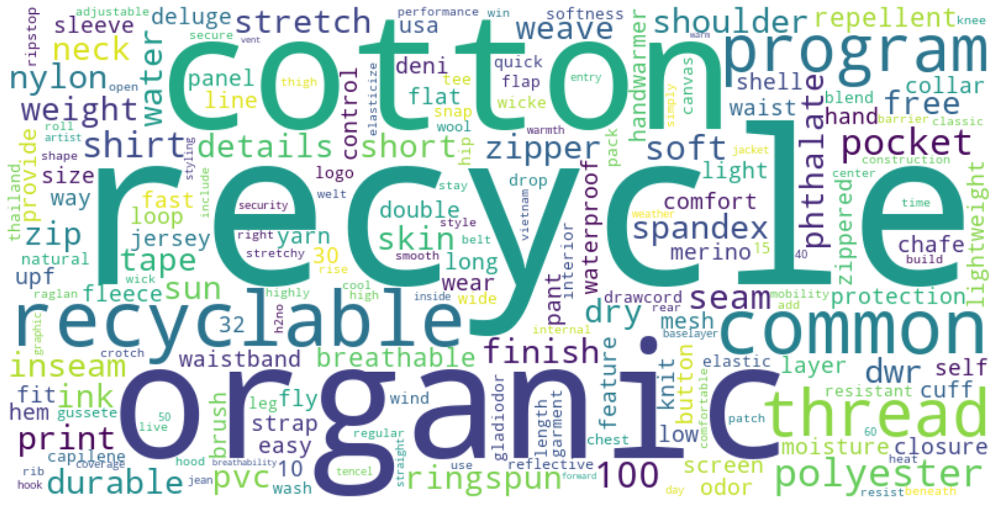

----------------
Wordcloud for  #topic_2


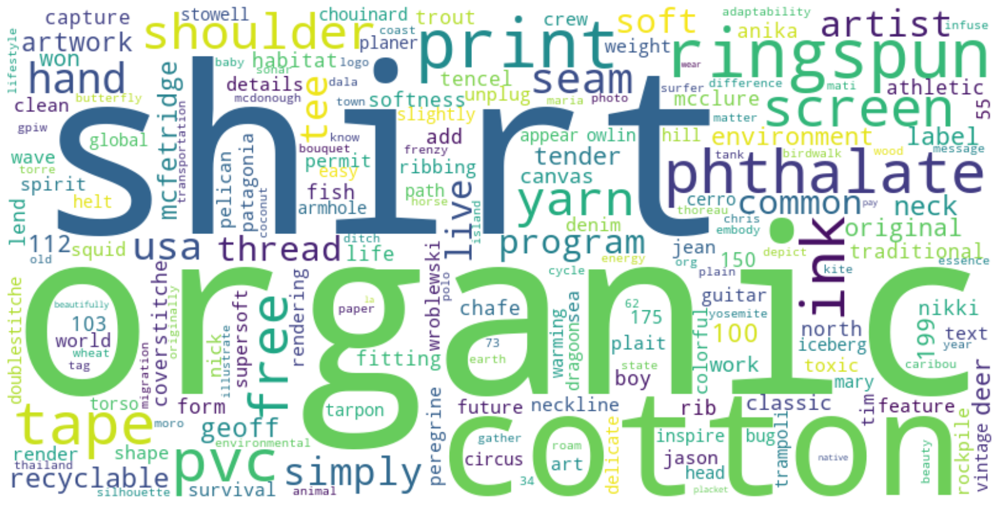

----------------
Wordcloud for  #topic_3


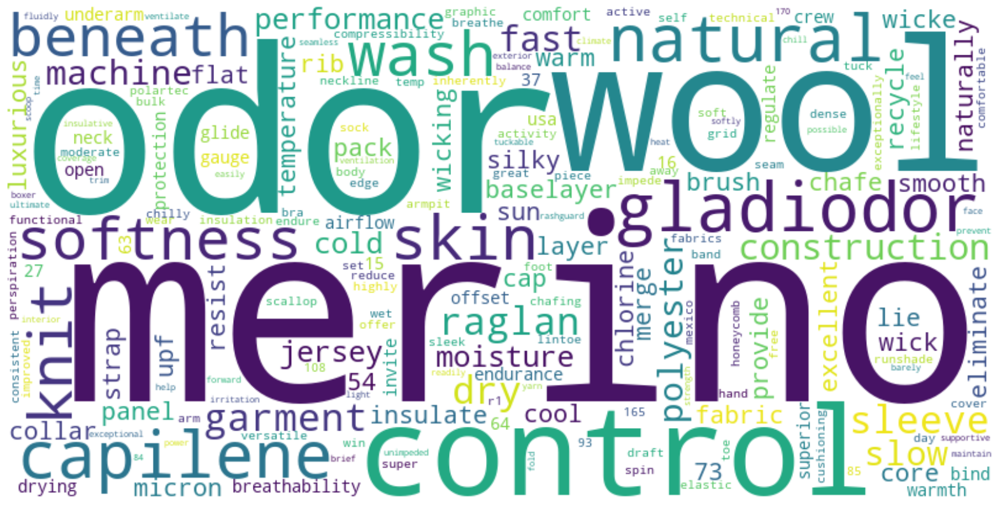

----------------
Wordcloud for  #topic_4


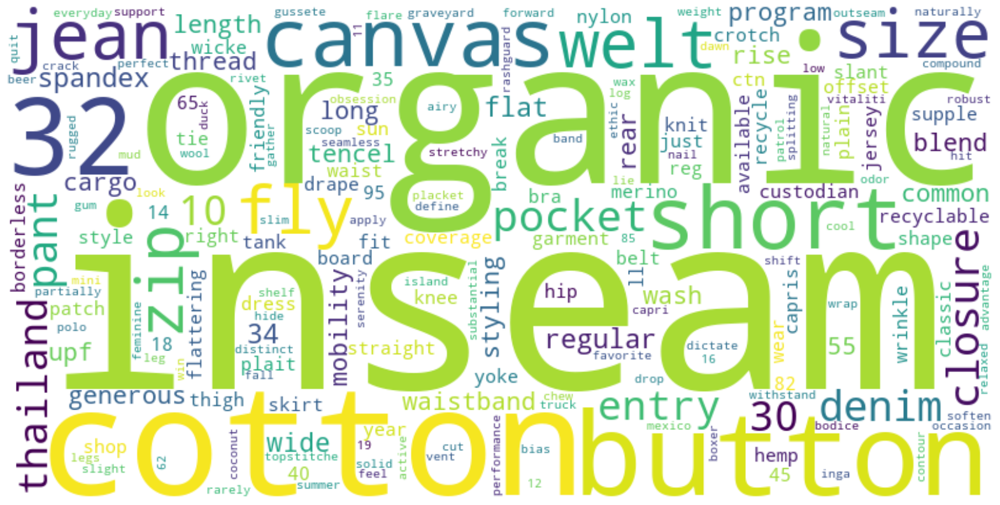

----------------
Wordcloud for  #topic_5


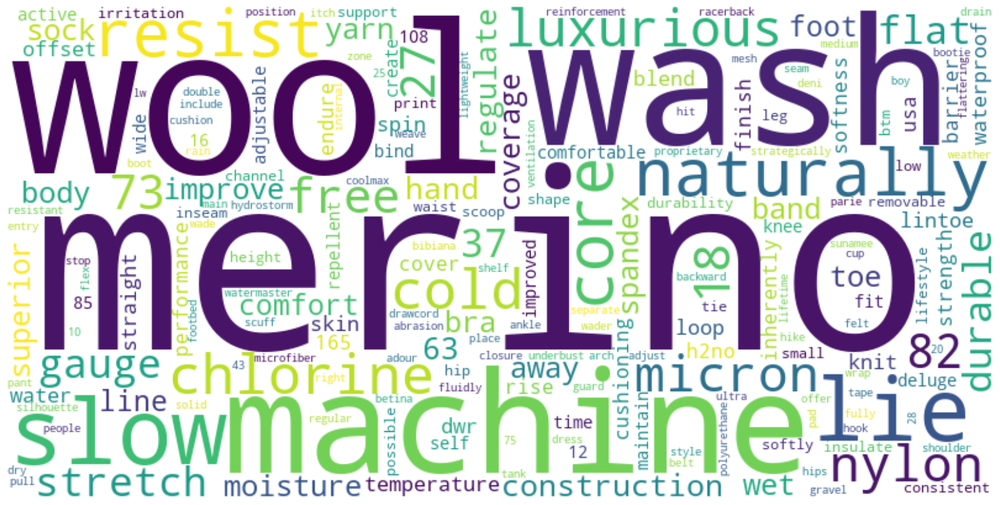

----------------
Wordcloud for  #topic_6


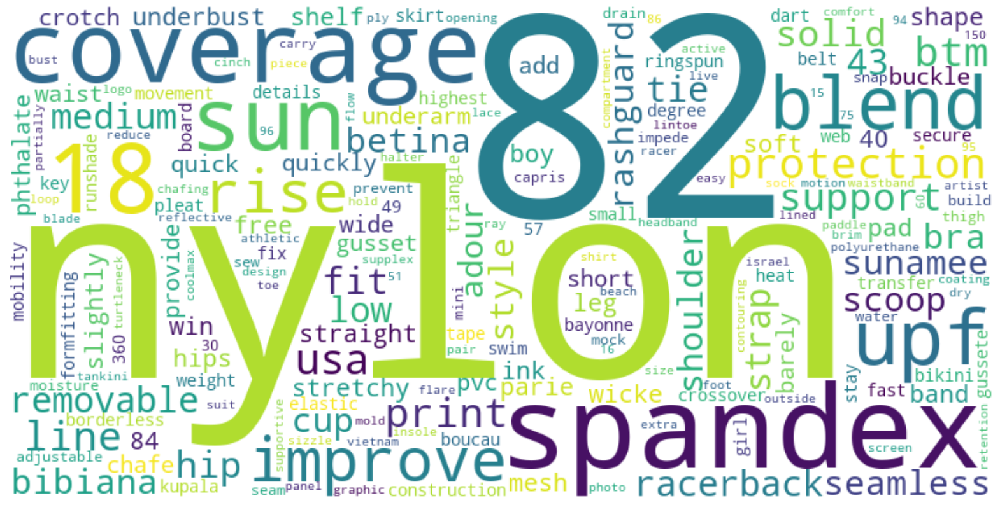

----------------
Wordcloud for  #topic_7


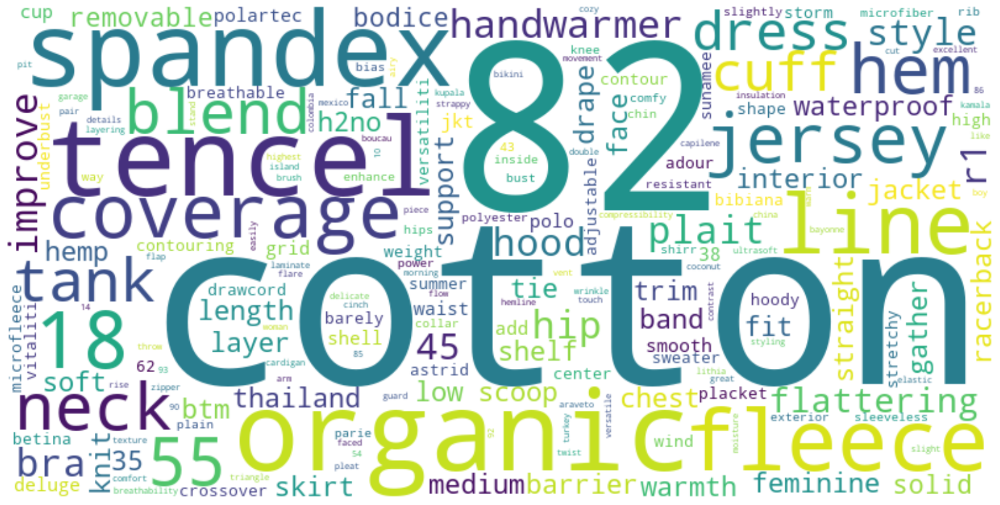

----------------
Wordcloud for  #topic_8


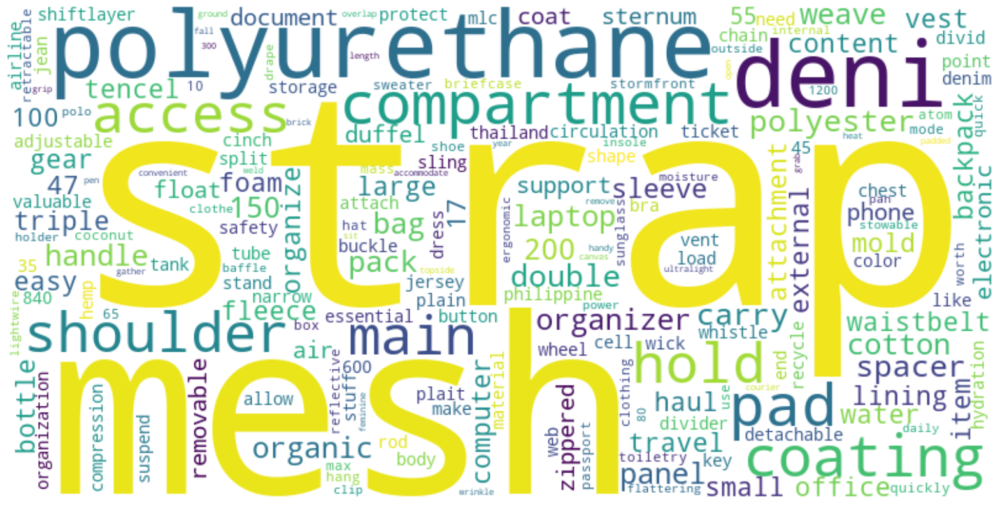

----------------
Wordcloud for  #topic_9


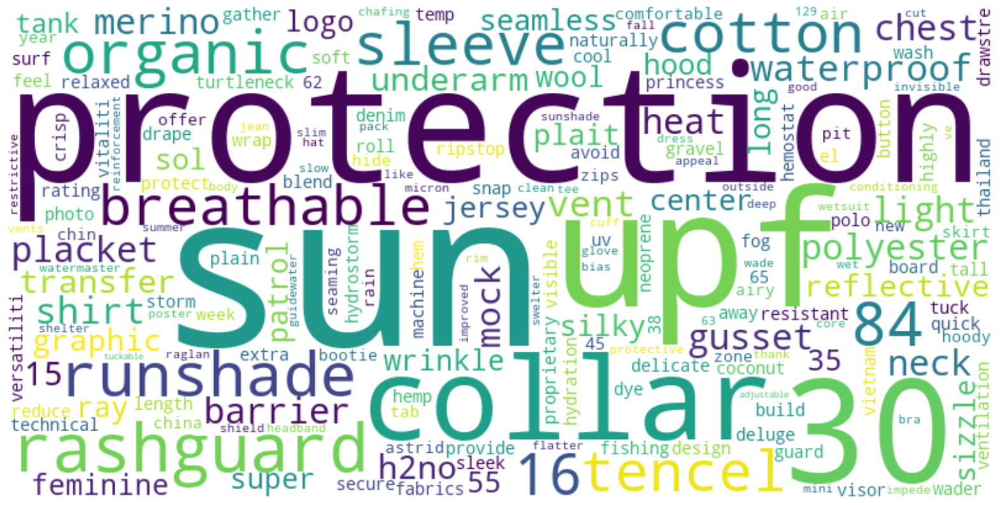

----------------
Wordcloud for  #topic_10


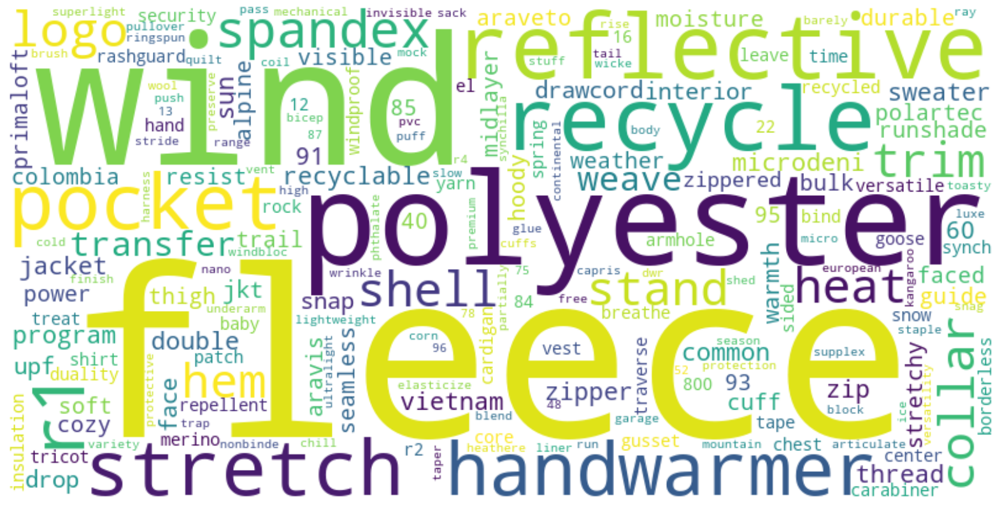

----------------
Wordcloud for  #topic_11


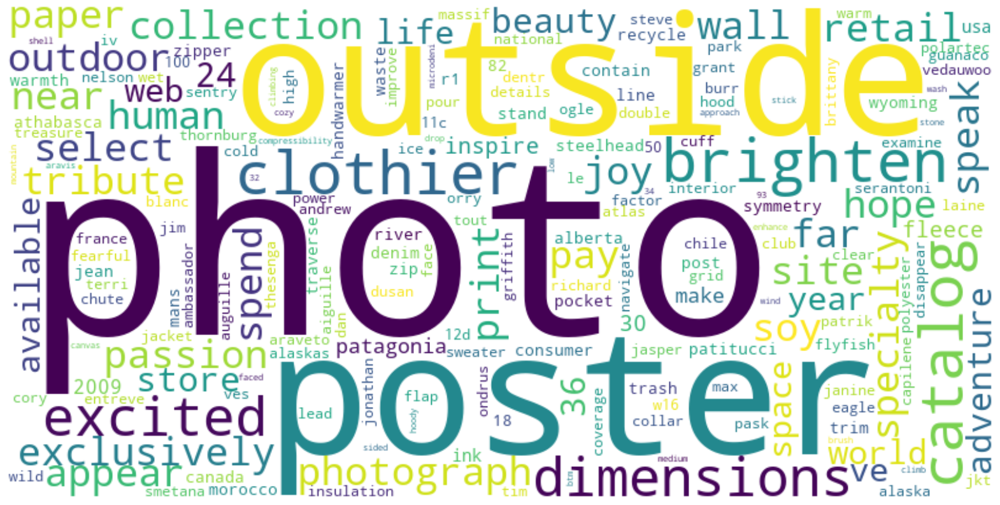

----------------
Wordcloud for  #topic_12


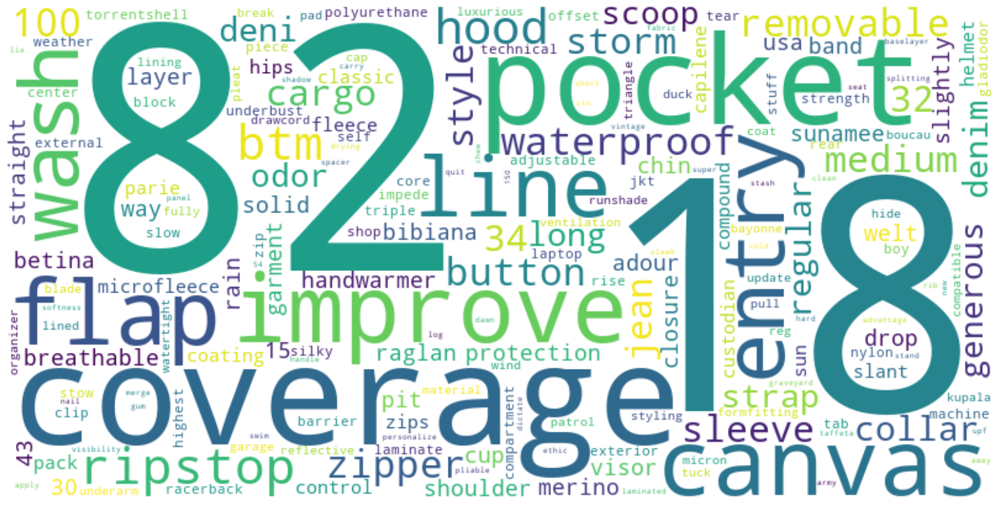

----------------
Wordcloud for  #topic_13


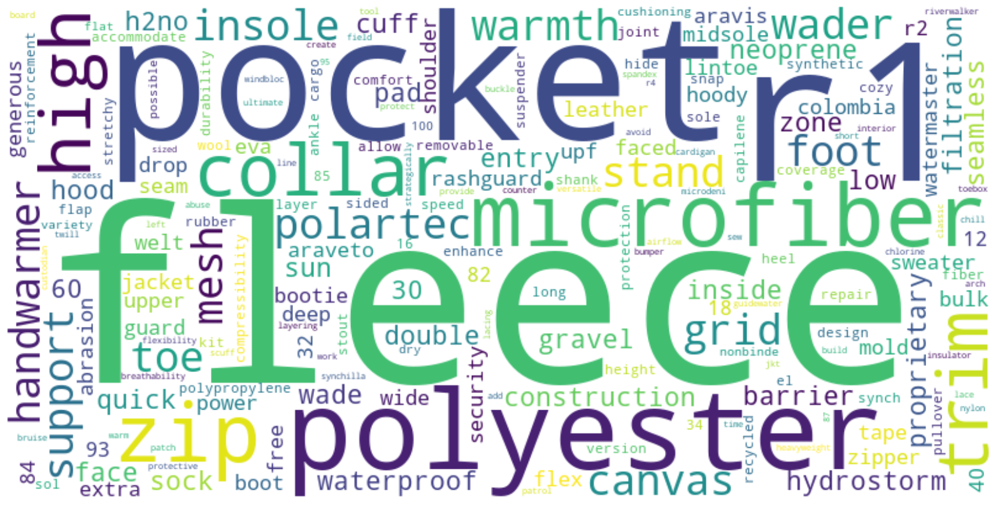

----------------
Wordcloud for  #topic_14


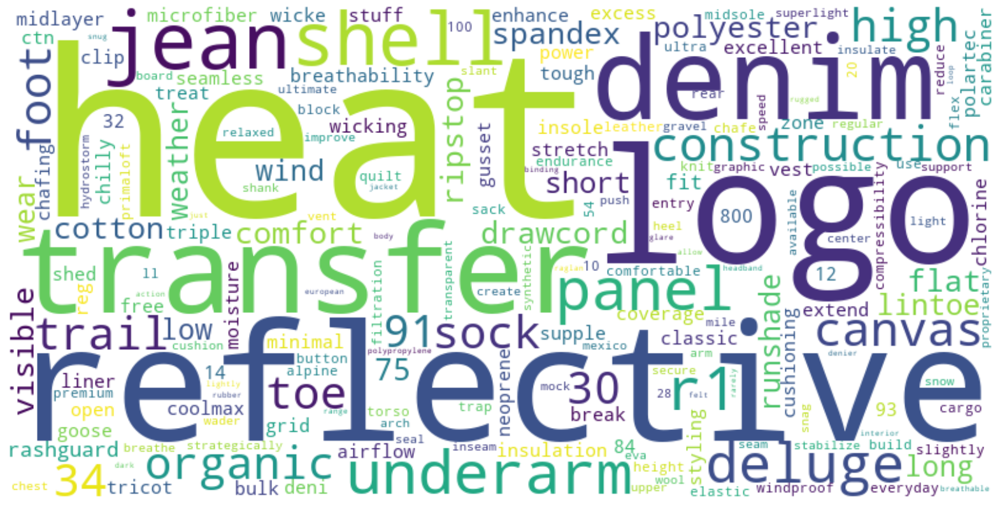

----------------
Wordcloud for  #topic_15


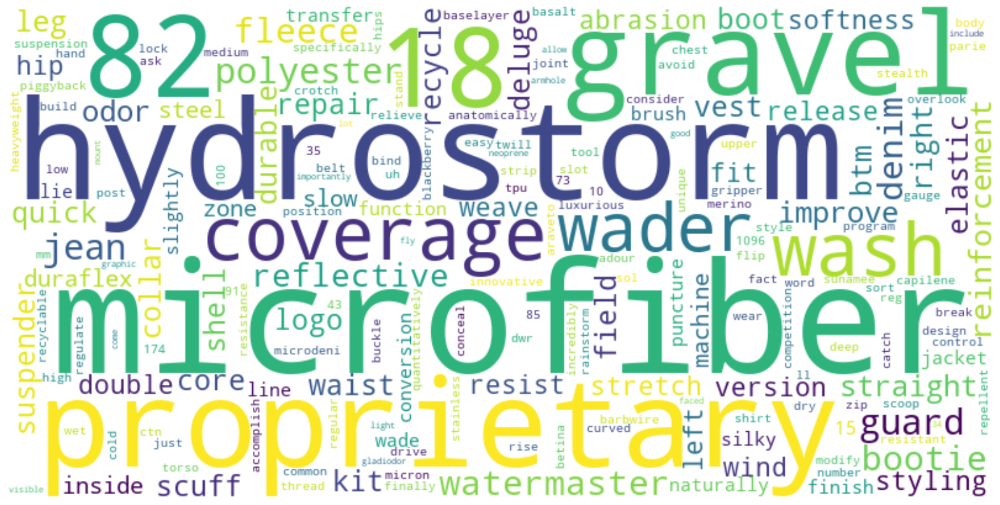

----------------
Wordcloud for  #topic_16


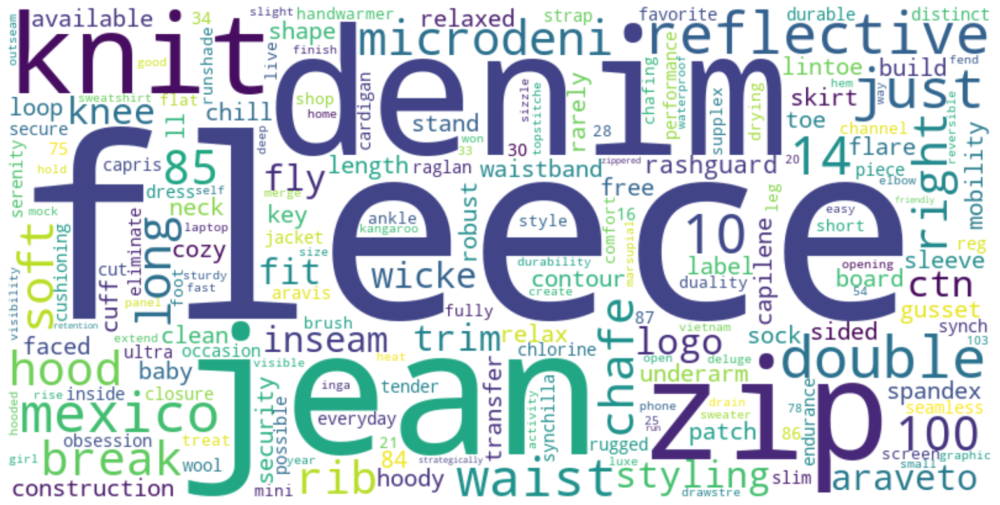

----------------
Wordcloud for  #topic_17


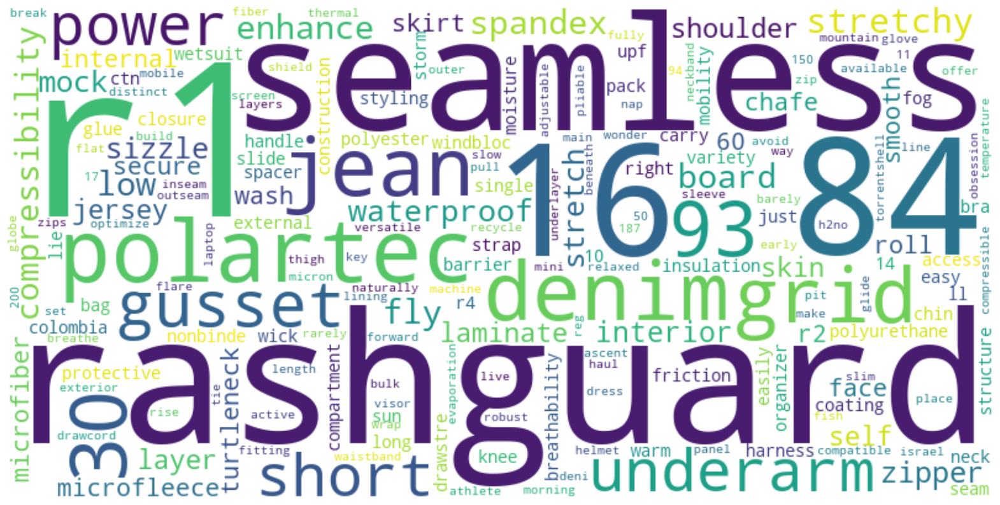

----------------
Wordcloud for  #topic_18


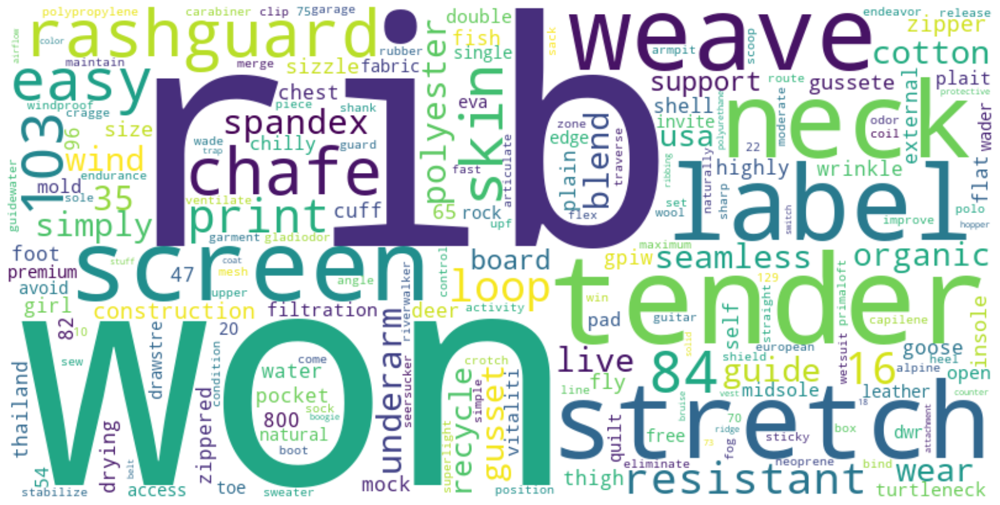

----------------
Wordcloud for  #topic_19


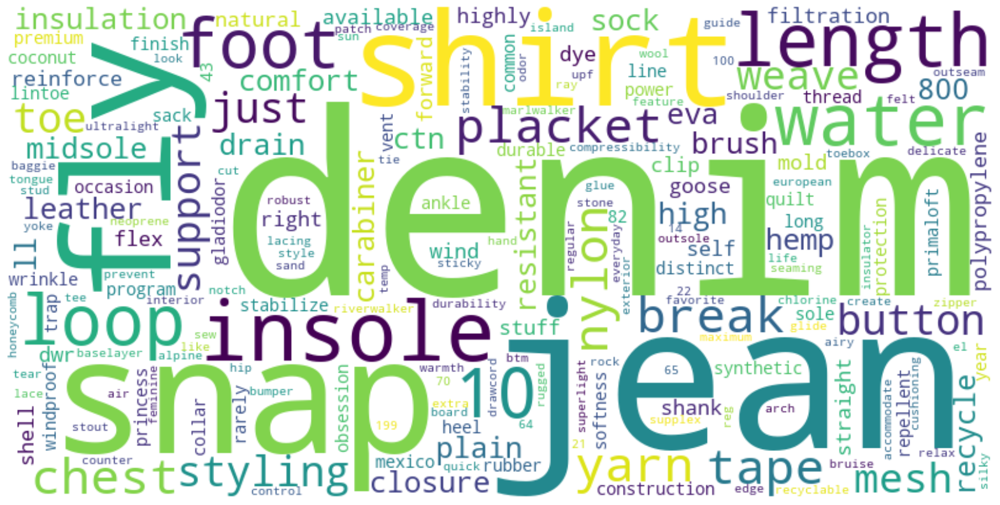

----------------
Wordcloud for  #topic_20


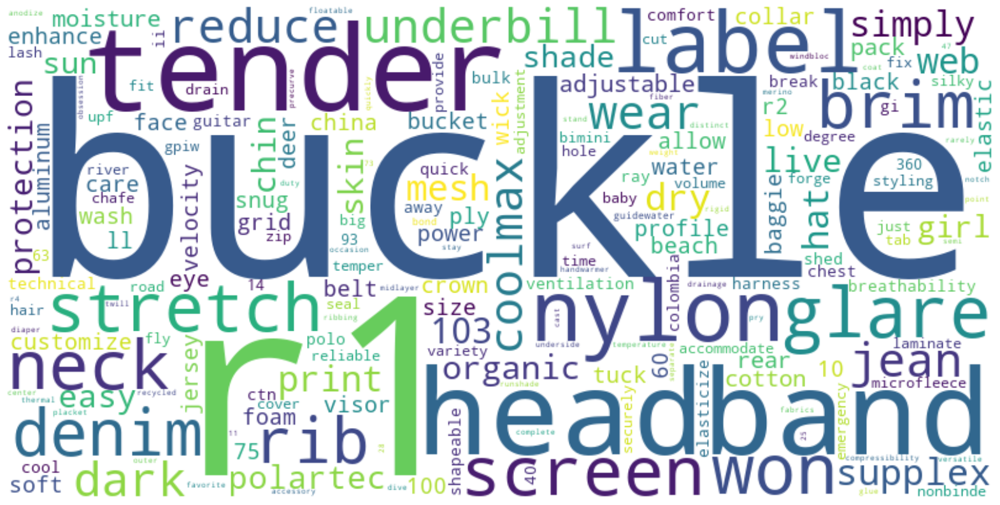

In [28]:
from wordcloud import WordCloud

for column in  ["topic_{}".format(i+1) for i in range(20)]:
    word_freq = topic_t[column].to_dict()

    cloud  = WordCloud(background_color="white", contour_width=1, contour_color='steelblue',width=800, height=400).generate_from_frequencies(word_freq)
    #no stop words as it is ignored when using from_frequencies

    print("----------------")
    print('Wordcloud for  #{}'.format(column))

    # Show plot
    plt.figure(figsize=(20, 20))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()